In [11]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import pydotplus
from IPython.display import Image, display

## Score Comparison

In [12]:
auprc_path = "Beeline/outputs/example/GSD-AUPRC.csv"
auroc_path = "Beeline/outputs/example/GSD-AUROC.csv"
epr_activation_path = "Beeline/outputs/example/GSD-EPr-Activation.csv"
epr_inhibitory_path = "Beeline/outputs/example/GSD-EPr-Inhibitory.csv"
epr_path = "Beeline/outputs/example/GSD-EPr.csv"

In [13]:
df_auprc = pd.read_csv(auprc_path, index_col=0)
df_auroc = pd.read_csv(auroc_path, index_col=0)
df_epr_activation = pd.read_csv(epr_activation_path, index_col=0)
df_epr_inhibitory = pd.read_csv(epr_inhibitory_path, index_col=0)
df_epr = pd.read_csv(epr_path, index_col=0)

In [14]:
df_auprc.rename(columns={"GSD": "AUPRC"}, inplace=True)
df_auroc.rename(columns={"GSD": "AUROC"}, inplace=True)
df_epr_activation.rename(columns={"GSD": "EPr-Activation"}, inplace=True)
df_epr_inhibitory.rename(columns={"GSD": "EPr-Inhibitory"}, inplace=True)
df_epr.rename(columns={"GSD": "EPr"}, inplace=True)

In [15]:
df_result = pd.concat(
    [df_auprc, df_auroc, df_epr_activation, df_epr_inhibitory, df_epr], axis=1
)
df_result

,AUPRC,AUROC,EPr-Activation,EPr-Inhibitory,EPr
SCEGOT,0.259381,0.572566,0.186275,0.089286,0.267081
PIDC,0.322474,0.636723,0.306122,0.000000,0.368421
PPCOR,0.311661,0.595692,0.380000,0.000000,0.315789
SCODE,0.284428,0.566828,0.265306,0.185185,0.289474
SINCERITIES,0.239077,0.556243,0.163265,0.148148,0.223684
LEAP,0.312526,0.631678,0.367347,0.185185,0.342105
SCRIBE,0.333321,0.652454,0.244898,0.222222,0.355263


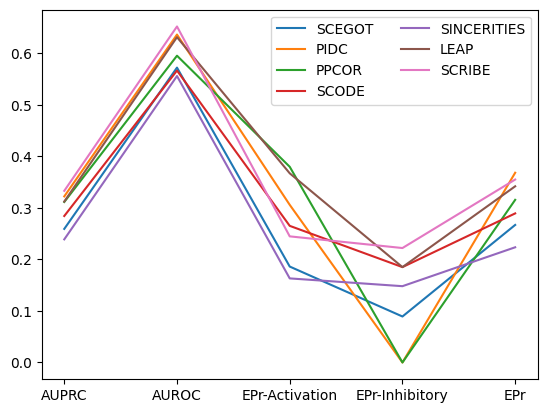

In [16]:
for tpl in df_result.itertuples():
    plt.plot(df_result.columns, tpl[1:], label=tpl.Index)
plt.legend(ncols=2, loc="upper right")

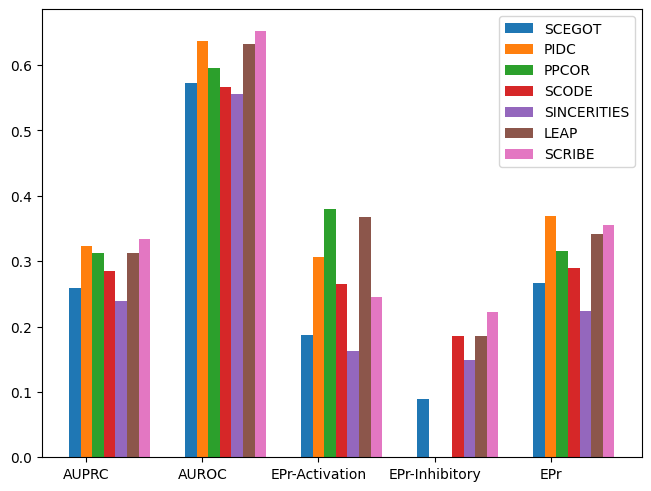

In [17]:
x = np.arange(len(df_result.columns))
bar_width = 0.1
fig, ax = plt.subplots(layout="constrained")
for i, tpl in enumerate(df_result.itertuples()):
    offset = i * bar_width
    rects = ax.bar(x + offset, tpl[1:], bar_width, label=tpl.Index)
    # ax.bar_label(rects, padding=3)
ax.set_xticks(x + bar_width, df_result.columns)
plt.legend()
fig.savefig("../figure/beeline_compare.jpeg", format="jpeg", dpi=300, bbox_inches="tight")

## Graph Comparison

In [18]:
def show_grn_graph(grn, save=False, save_path=None):
    graph = pydotplus.Dot(graph_type="digraph")
    for c in np.unique(np.concatenate([grn["Gene1"], grn["Gene2"]])):
        node = pydotplus.Node(c, label=c)
        graph.add_node(node)
    for tpl in grn.itertuples():
        edge = pydotplus.Edge(
            graph.get_node(tpl.Gene1)[0], graph.get_node(tpl.Gene2)[0]
        )
        edge.set_label(f"{tpl.EdgeWeight:.2f}")
        # edge.set_penwidth(20 * abs(tpl.EdgeWeight) + 0.5)
        h, s, v = 0.0 if tpl.EdgeWeight > 0 else 2 / 3, abs(tpl.EdgeWeight) + 1, 1.0
        edge.set_color(" ".join([str(i) for i in [h, s, v]]))
        graph.add_edge(edge)
    display(Image(graph.create_png()))
    if save:
        graph.write_png(save_path)

SCEGOT


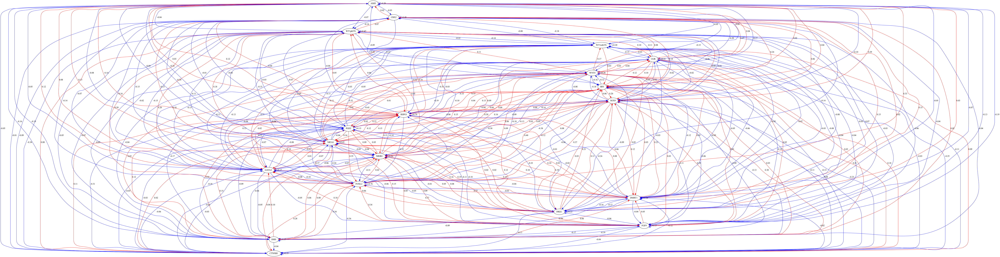

PIDC


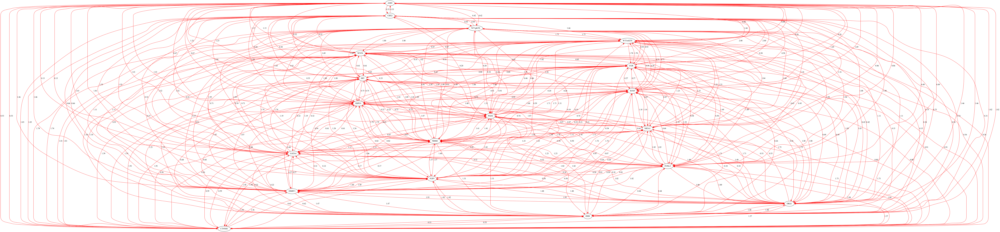

PPCOR


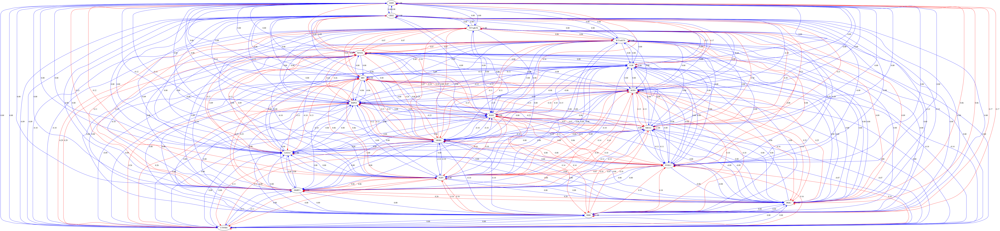

SCODE


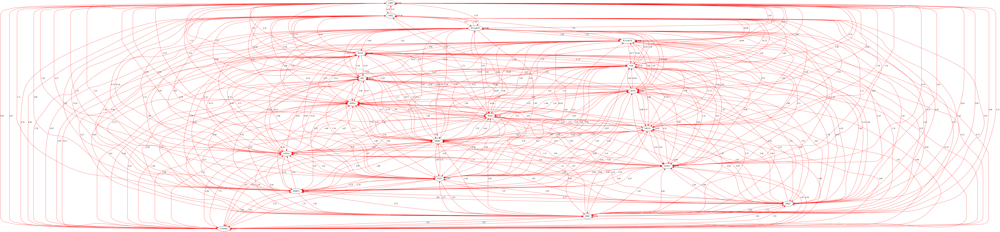

SINCERITIES


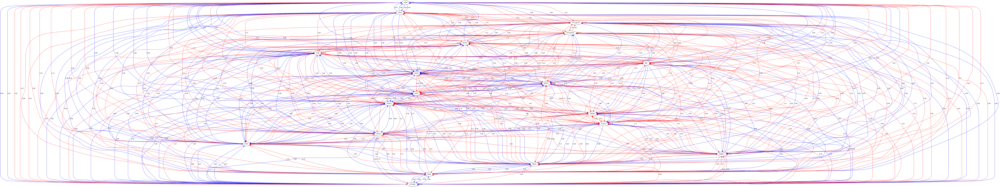

LEAP


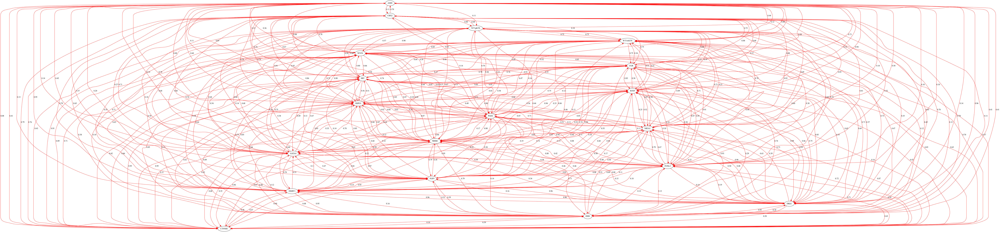

SCRIBE


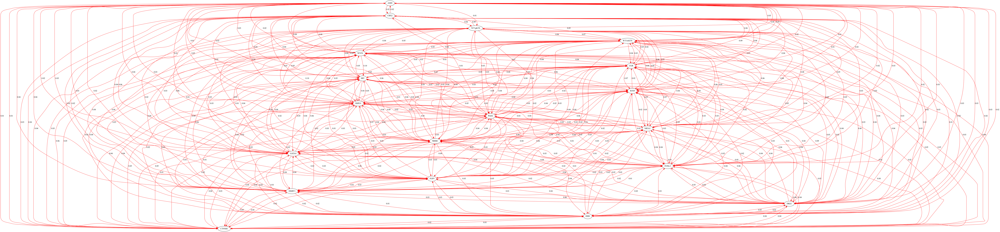

In [19]:
for method_name in df_result.index:
    ranked_edges = pd.read_table(
        f"Beeline/outputs/example/GSD/{method_name}/rankedEdges.csv"
    )
    print(method_name)
    show_grn_graph(ranked_edges)